# Установка завимостей

In [ ]:
%%capture
!apt-get update -y
!apt-get install -y libosmesa6-dev libgl1-mesa-glx libgl1-mesa-dri libglew-dev libglfw3-dev
!pip install pyopengl imageio-ffmpeg
!pip install pyvirtualdisplay

In [ ]:
%%capture
!pip install tensorboard
!pip install gymnasium[mujoco]
!pip install stable-baselines3[extra]

In [ ]:
%load_ext tensorboard
%matplotlib inline

import os

os.environ['MUJOCO_GL'] = 'osmesa'
os.environ['PYOPENGL_PLATFORM'] = 'osmesa'

import gymnasium as gym
from gymnasium import envs
from stable_baselines3 import SAC, TD3, A2C, DQN, PPO

import argparse
from pathlib import Path
import glob

import numpy as np
import matplotlib.pyplot as plt
from IPython import display as ipythondisplay

from pyvirtualdisplay import Display

Gym has been unmaintained since 2022 and does not support NumPy 2.0 amongst other critical functionality.
Please upgrade to Gymnasium, the maintained drop-in replacement of Gym, or contact the authors of your software and request that they upgrade.
See the migration guide at https://gymnasium.farama.org/introduction/migration_guide/ for additional information.
/usr/local/lib/python3.12/dist-packages/jupyter_client/session.py:203: DeprecationWarning: datetime.datetime.utcnow() is deprecated and scheduled for removal in a future version. Use timezone-aware objects to represent datetimes in UTC: datetime.datetime.now(datetime.UTC).
  return datetime.utcnow().replace(tzinfo=utc)


# Обучение агента

Создаем директории для хранения логов и обученных моделей. Обратите внимание, что при перезапуске среды обучения сохранённые здесь файлы будут удалены - так что перед закрытием colab скачайте обученные модели, если они вам будут нужны.

In [ ]:
local_download_path = ''

In [ ]:
# Модели и логи можно сохранить на гугл диске, а не локально (тогда при перезапуске среды они не удалены). Для этого вам нужно иметь гугл-аккаунт и раскомментировать этот код

# from google.colab import drive
# drive.mount('/content/drive')

# local_download_path = "/content/drive/My Drive/Colab Notebooks/rl_workshop"

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
model_dir = os.path.join(local_download_path, "models")
log_dir =  os.path.join(local_download_path, "logs")
gif_dir =  os.path.join(local_download_path, "video")

os.makedirs(model_dir, exist_ok=True)
os.makedirs(log_dir, exist_ok=True)
os.makedirs(gif_dir, exist_ok=True)

In [ ]:
def train(env, sb3_algo, timesteps = 25000):
    if sb3_algo == 'SAC':
        model = SAC('MlpPolicy', env, verbose=1, device='cpu', tensorboard_log=log_dir,learning_rate=0.01)
    elif sb3_algo == 'TD3':
        model = TD3('MlpPolicy', env, verbose=1, device='cpu', tensorboard_log=log_dir)
    elif sb3_algo == 'A2C':
        model = A2C('MlpPolicy', env, verbose=1, device='cpu', tensorboard_log=log_dir)
    elif sb3_algo == 'DQN':
        model = DQN('MlpPolicy', env, verbose=1, device='cpu', tensorboard_log=log_dir)
    elif sb3_algo == 'PPO':
        model = PPO('MlpPolicy', env, verbose=1, device='cpu', tensorboard_log=log_dir)
    else:
        print('Algorithm not found!')
        return

    iters = 0
    while True:
        iters += 1

        model.learn(total_timesteps=timesteps, reset_num_timesteps=False)
        model.save(f"{model_dir}/{sb3_algo}_{timesteps * iters}")

In [ ]:
import imageio

def test(env, sb3_algo, path_to_model, num_steps=500, video_path=None):
    if sb3_algo == 'SAC':
        model = SAC.load(path_to_model, env=env)
    elif sb3_algo == 'TD3':
        model = TD3.load(path_to_model, env=env)
    elif sb3_algo == 'A2C':
        model = A2C.load(path_to_model, env=env)
    elif sb3_algo == 'DQN':
        model = DQN.load(path_to_model, env=env)
    elif sb3_algo == 'PPO':
        model = PPO.load(path_to_model, env=env)
    else:
        print('Algorithm not found!')
        return

    obs = env.reset()
    if isinstance(obs, tuple):
        obs = obs[0]

    if video_path:
        all_frames = []

    done = False
    extra_steps = 50
    counter = 0

    for step in range(num_steps):
        action, _ = model.predict(obs)
        obs, _, done, _, _ = env.step(action)

        if video_path and counter % 10:
            frame = env.render()
            all_frames.append(frame)

        counter += 1

        if done:
            extra_steps -= 1

            if extra_steps < 0:
                break


    env.close()

    if video_path:
        imageio.mimsave(video_path, all_frames, duration=0.05, loop=0)
        print(f"GIF сохранен: {video_path}")

## Обучение агента

Примеры [сред](https://gymnasium.farama.org/environments/mujoco/) в gymnasium

In [ ]:
print(envs.registry)

{'CartPole-v0': EnvSpec(id='CartPole-v0', entry_point='gymnasium.envs.classic_control.cartpole:CartPoleEnv', reward_threshold=195.0, nondeterministic=False, max_episode_steps=200, order_enforce=True, disable_env_checker=False, kwargs={}, namespace=None, name='CartPole', version=0, additional_wrappers=(), vector_entry_point='gymnasium.envs.classic_control.cartpole:CartPoleVectorEnv'), 'CartPole-v1': EnvSpec(id='CartPole-v1', entry_point='gymnasium.envs.classic_control.cartpole:CartPoleEnv', reward_threshold=475.0, nondeterministic=False, max_episode_steps=500, order_enforce=True, disable_env_checker=False, kwargs={}, namespace=None, name='CartPole', version=1, additional_wrappers=(), vector_entry_point='gymnasium.envs.classic_control.cartpole:CartPoleVectorEnv'), 'MountainCar-v0': EnvSpec(id='MountainCar-v0', entry_point='gymnasium.envs.classic_control.mountain_car:MountainCarEnv', reward_threshold=-110.0, nondeterministic=False, max_episode_steps=200, order_enforce=True, disable_env_ch

Действия и наблюдения в среде [Hopper-v5](https://gymnasium.farama.org/environments/mujoco/hopper/):

**Пространство действий**

Действие представляет собой крутящие моменты, приложенные к шарнирным соединениям. Box(-1, 1, (3,), float32)


| Num | Action                             | Control Min | Control Max | Name (in corresponding XML file) | Joint | Type (Unit)  |
|-----|------------------------------------|-------------|-------------|----------------------------------|-------|--------------|
| 0   | Крутящий момент, приложенный к thigh rotor  | -1          | 1           | thigh_joint                      | hinge | torque (N m) |
| 1   | Крутящий момент, приложенный к leg rotor    | -1          | 1           | leg_joint                        | hinge | torque (N m) |
| 2   | Крутящий момент, приложенный к foot rotor   | -1          | 1           | foot_joint                       | hinge | torque (N m) |


**Пространство наблюдений**

- qpos (5 элементов по умолчанию): Значения положения частей тела робота.
- qvel (6 элементов): Скорости этих отдельных частей тела (их производных).

| Num | Observation                                        | Min  | Max | Name (in corresponding XML file) | Joint | Type (Unit)              |
| --- | -------------------------------------------------- | ---- | --- | -------------------------------- | ----- | ------------------------ |
| 0   | z-coordinate of the torso (height of hopper)       | -Inf | Inf | rootz                            | slide | position (m)             |
| 1   | angle of the torso                                 | -Inf | Inf | rooty                            | hinge | angle (rad)              |
| 2   | angle of the thigh joint                           | -Inf | Inf | thigh_joint                      | hinge | angle (rad)              |
| 3   | angle of the leg joint                             | -Inf | Inf | leg_joint                        | hinge | angle (rad)              |
| 4   | angle of the foot joint                            | -Inf | Inf | foot_joint                       | hinge | angle (rad)              |
| 5   | velocity of the x-coordinate of the torso          | -Inf | Inf | rootx                          | slide | velocity (m/s)           |
| 6   | velocity of the z-coordinate (height) of the torso | -Inf | Inf | rootz                          | slide | velocity (m/s)           |
| 7   | angular velocity of the angle of the torso         | -Inf | Inf | rooty                          | hinge | angular velocity (rad/s) |
| 8   | angular velocity of the thigh hinge                | -Inf | Inf | thigh_joint                      | hinge | angular velocity (rad/s) |
| 9   | angular velocity of the leg hinge                  | -Inf | Inf | leg_joint                        | hinge | angular velocity (rad/s) |
| 10  | angular velocity of the foot hinge                 | -Inf | Inf | foot_joint                       | hinge | angular velocity (rad/s) |
| excluded | x-coordinate of the torso                     | -Inf | Inf | rootx      

In [ ]:
gymenv_name = "Hopper-v5"
env = gym.make(gymenv_name, render_mode="rgb_array")

env.action_space, env.observation_space

(Box(-1.0, 1.0, (3,), float32), Box(-inf, inf, (11,), float64))

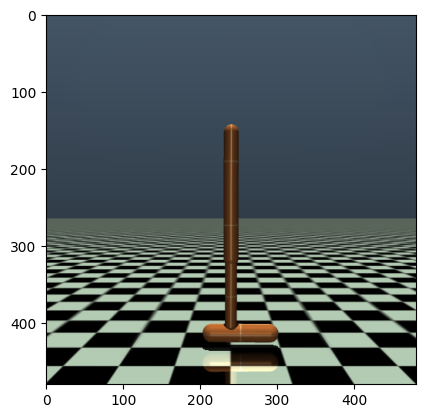

In [ ]:
s, _ = env.reset()
plt.imshow(env.render())

In [ ]:
sb3_algo = "PPO"
gymenv_name = "Hopper-v5"
render_mode = None

In [ ]:
%load_ext tensorboard
%tensorboard --logdir "logs"
# %tensorboard --logdir "/content/drive/My Drive/Colab Notebooks/rl_workshop/logs"

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

/usr/local/lib/python3.12/dist-packages/jupyter_client/session.py:203: DeprecationWarning: datetime.datetime.utcnow() is deprecated and scheduled for removal in a future version. Use timezone-aware objects to represent datetimes in UTC: datetime.datetime.now(datetime.UTC).
  return datetime.utcnow().replace(tzinfo=utc)


In [ ]:
gymenv = gym.make(gymenv_name, render_mode=render_mode)
train(gymenv, sb3_algo, timesteps=8000000)

Using cpu device
Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.
Logging to logs/PPO_0
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 18.3     |
|    ep_rew_mean     | 12.8     |
| time/              |          |
|    fps             | 880      |
|    iterations      | 1        |
|    time_elapsed    | 2        |
|    total_timesteps | 2048     |
---------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 24.2        |
|    ep_rew_mean          | 24.6        |
| time/                   |             |
|    fps                  | 654         |
|    iterations           | 2           |
|    time_elapsed         | 6           |
|    total_timesteps      | 4096        |
| train/                  |             |
|    approx_kl            | 0.017343912 |
|    clip_fraction        | 0.21        |
|    clip_range           | 0.2         

KeyboardInterrupt: 

## Тестирование обученного агента

In [ ]:
import re

def extract_number(filename):
    """Extract the numeric suffix from a filename like SAC_123456.zip"""
    basename = os.path.basename(filename)
    match = re.search(r'(\d+)(?=\.\w+$)', basename)
    return int(match.group(1)) if match else -1

In [ ]:
# список директорий с обученными моделями

list(glob.glob(model_dir+'/*/'))

['/content/drive/My Drive/Colab Notebooks/rl_workshop/models/models_Hopper-v5_backward/',
 '/content/drive/My Drive/Colab Notebooks/rl_workshop/models/models_Hopper-v5jump_in_place/',
 '/content/drive/My Drive/Colab Notebooks/rl_workshop/models/models_Hopper-v5/',
 '/content/drive/My Drive/Colab Notebooks/rl_workshop/models/models_robodog/',
 '/content/drive/My Drive/Colab Notebooks/rl_workshop/models/models_Ant-v5/']

In [ ]:
last_models = list(glob.glob(model_dir + '/models_Hopper-v5jump_in_place/*/SAC*.zip'))
last_models.sort(key=extract_number)

last_models

['/content/drive/My Drive/Colab Notebooks/rl_workshop/models/models_Hopper-v5jump_in_place/SAC/SAC_25000.zip',
 '/content/drive/My Drive/Colab Notebooks/rl_workshop/models/models_Hopper-v5jump_in_place/SAC/SAC_50000.zip',
 '/content/drive/My Drive/Colab Notebooks/rl_workshop/models/models_Hopper-v5jump_in_place/SAC/SAC_75000.zip',
 '/content/drive/My Drive/Colab Notebooks/rl_workshop/models/models_Hopper-v5jump_in_place/SAC/SAC_100000.zip',
 '/content/drive/My Drive/Colab Notebooks/rl_workshop/models/models_Hopper-v5jump_in_place/SAC/SAC_125000.zip',
 '/content/drive/My Drive/Colab Notebooks/rl_workshop/models/models_Hopper-v5jump_in_place/SAC/SAC_150000.zip',
 '/content/drive/My Drive/Colab Notebooks/rl_workshop/models/models_Hopper-v5jump_in_place/SAC/SAC_175000.zip',
 '/content/drive/My Drive/Colab Notebooks/rl_workshop/models/models_Hopper-v5jump_in_place/SAC/SAC_200000.zip',
 '/content/drive/My Drive/Colab Notebooks/rl_workshop/models/models_Hopper-v5jump_in_place/SAC/SAC_225000.z

In [ ]:
sb3_algo = "SAC"
gymenv_name = "Hopper-v5"
render_mode = 'rgb_array'
gif_path = os.path.join(gif_dir, gymenv_name + "_" + sb3_algo + ".gif")

path_to_model = last_models[-1]

In [ ]:
gymenv = gym.make(gymenv_name, render_mode=render_mode)
test(gymenv, sb3_algo, path_to_model=path_to_model, video_path=gif_path, num_steps=500)

Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.
GIF сохранен: /content/drive/My Drive/Colab Notebooks/rl_workshop/video/Hopper-v5_SAC.gif


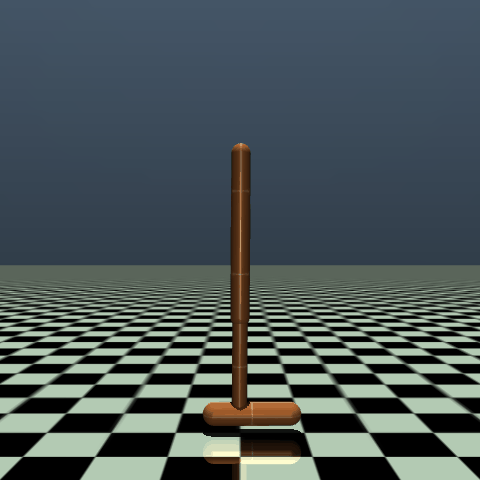

In [ ]:
from IPython.display import Image, display

try:
    display(Image(filename=gif_path, width=500))
except FileNotFoundError:
    print(f"Ошибка: Файл GIF '{gif_path}' не найден.")

# Задача

Модифицируйте функцию награды одноногого робота так, чтобы он научился ходить в обратном направлении

В реапозитории gymnasium можно посмотреть, как реализован [Hopper-v5](https://github.com/Farama-Foundation/Gymnasium/blob/main/gymnasium/envs/mujoco/hopper_v5.py) и другие среды-примеры.

Чтобы изменить поведение робота в Hopper-v5 (например, заставить его двигаться назад, вращаться по кругу или выполнять другие действия), надо изменить его награду. Для этого вы можете либо скопировать оригинальный код Hopper-V5 и переписать награду, либо использовать пользовательский [RewardWrapper](https://gymnasium.farama.org/tutorials/gymnasium_basics/implementing_custom_wrappers/#sphx-glr-tutorials-gymnasium-basics-implementing-custom-wrappers-py) из Gymnasium.

В качестве примера научим ногу прыгать на месте.

In [ ]:
from gymnasium import RewardWrapper
import numpy as np

class HopperCustomRewardWrapper(RewardWrapper):

    def __init__(self, env):
        super().__init__(env)

    def reward(self, original_reward):
        # Доступ к данным MuJoCo через unwrapped environment
        # Hopper state: qpos = [x, z, angle, leg angles...]
        #               qvel = [x_vel, z_vel, angular_vel, ...]

        x_pos = self.unwrapped.data.qpos[0]      # горизонтальное положение
        x_vel = self.unwrapped.data.qvel[0]      # горизонтальная скорость
        z_vel = self.unwrapped.data.qvel[1]      # вертикальная скорость

        # Информация о выживании (из оригинального окружения, здесь ничего не меняем)
        is_healthy = self.unwrapped.is_healthy
        healthy_reward = 1.0 if is_healthy else 0.0

        # Цель: оставаться вблизи исходной точки и прыгать вертикально
        # Решение: Штрафовать за горизонтальное движение
        x_penalty = -0.5 * np.abs(x_vel)          # Не поощряйте горизонтальные движения по х.
        # Поощряйте вертикальные движения (прыжки).
        vertical_reward = 1.0 * np.abs(z_vel)     # Вознаграждение за движение вверх/вниз
        # Необязательно: вознаграждение за остановку в точке старта (x ≈ 0)
        position_penalty = -0.1 * np.abs(x_pos)   # держаться ближе к исходному положению

        behavior_reward = vertical_reward + x_penalty + position_penalty

        # Совмещаем обе награды
        total_reward = behavior_reward + 0.1 * healthy_reward

        return float(total_reward)

In [ ]:
sb3_algo = "SAC"
gymenv_name = "Hopper-v5"

base_env = gym.make(gymenv_name, render_mode=None)
gymenv = HopperCustomRewardWrapper(base_env)

In [ ]:
train(gymenv, sb3_algo)

Using cpu device
Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.
Logging to logs_humanoid_standup/SAC_0


/usr/local/lib/python3.12/dist-packages/jupyter_client/session.py:203: DeprecationWarning: datetime.datetime.utcnow() is deprecated and scheduled for removal in a future version. Use timezone-aware objects to represent datetimes in UTC: datetime.datetime.now(datetime.UTC).
  return datetime.utcnow().replace(tzinfo=utc)


Streaming output truncated to the last 5000 lines.
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.4     |
|    ep_rew_mean     | 11.3     |
| time/              |          |
|    episodes        | 3508     |
|    fps             | 25       |
|    time_elapsed    | 494      |
|    total_timesteps | 87512    |
| train/             |          |
|    actor_loss      | -8.17    |
|    critic_loss     | 0.313    |
|    ent_coef        | 0.00437  |
|    ent_coef_loss   | 7.14     |
|    learning_rate   | 0.01     |
|    n_updates       | 87411    |
---------------------------------
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 10.4     |
|    ep_rew_mean     | 11.3     |
| time/              |          |
|    episodes        | 3512     |
|    fps             | 25       |
|    time_elapsed    | 495      |
|    total_timesteps | 87556    |
| train/             |         

Подумайте, как изменить награду, чтобы нога научилась прыгать назад.

# Робособака

https://gymnasium.farama.org/v1.0.0/tutorials/gymnasium_basics/load_quadruped_model/

Можно использовать фреймворк MuJoCo/Ant-v5 для создания четвероногой среды ходьбы с помощью файла модели (с расширением .xml) без необходимости создания нового класса.

Для этого нужно создать или скачать файл модели MJCF (или URDF) вашего робота и загрузить эту модель с аргументом xml_file.

Мы загрузим робота [Unitree Go1](https://github.com/google-deepmind/mujoco_menagerie/blob/main/unitree_go1/README.md) из коллекции моделей роботов [MuJoCo Menagerie](https://github.com/google-deepmind/mujoco_menagerie).

Go1 — четвероногий робот, управление которым представляет собой серьёзную проблему обучения, гораздо сложнее, чем в среде Gymnaium/MuJoCo/Ant.

In [ ]:
!git clone https://github.com/google-deepmind/mujoco_menagerie.git

Cloning into 'mujoco_menagerie'...
remote: Enumerating objects: 5969, done.
remote: Counting objects: 100% (59/59), done.
remote: Compressing objects: 100% (45/45), done.
remote: Total 5969 (delta 27), reused 14 (delta 14), pack-reused 5910 (from 3)
Receiving objects: 100% (5969/5969), 413.33 MiB | 18.24 MiB/s, done.
Resolving deltas: 100% (1978/1978), done.
Updating files: 100% (2109/2109), done.


In [ ]:
gymenv = gym.make(
    'Ant-v5',
    xml_file='./mujoco_menagerie/unitree_go1/scene.xml',
    forward_reward_weight=1,
    ctrl_cost_weight=0.05,
    contact_cost_weight=5e-4,
    healthy_reward=1,
    main_body=1,
    healthy_z_range=(0.195, 0.75),
    include_cfrc_ext_in_observation=True,
    exclude_current_positions_from_observation=False,
    reset_noise_scale=0.1,
    frame_skip=25,
    max_episode_steps=1000,
)

In [ ]:
sb3_algo = "PPO"
train(gymenv, sb3_algo)

Using cpu device
Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.
Logging to logs_humanoid_standup/PPO_0


/usr/local/lib/python3.12/dist-packages/jupyter_client/session.py:203: DeprecationWarning: datetime.datetime.utcnow() is deprecated and scheduled for removal in a future version. Use timezone-aware objects to represent datetimes in UTC: datetime.datetime.now(datetime.UTC).
  return datetime.utcnow().replace(tzinfo=utc)


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 14.7     |
|    ep_rew_mean     | 2.49     |
| time/              |          |
|    fps             | 301      |
|    iterations      | 1        |
|    time_elapsed    | 6        |
|    total_timesteps | 2048     |
---------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 15.9        |
|    ep_rew_mean          | 2.98        |
| time/                   |             |
|    fps                  | 282         |
|    iterations           | 2           |
|    time_elapsed         | 14          |
|    total_timesteps      | 4096        |
| train/                  |             |
|    approx_kl            | 0.019644793 |
|    clip_fraction        | 0.205       |
|    clip_range           | 0.2         |
|    entropy_loss         | -17         |
|    explained_variance   | -0.08       |
|    learning_rate        | 0.

KeyboardInterrupt: 

In [ ]:
last_models = list(glob.glob(model_dir + '/models_Hopper-v5jump_in_place/*/SAC*.zip'))
last_models.sort(key=extract_number)

last_models

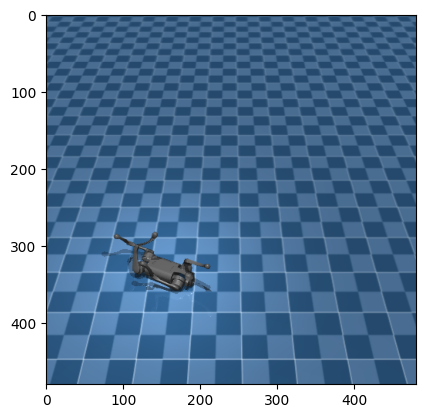

KeyboardInterrupt: 

Error in callback <function flush_figures at 0x793badb1a2a0> (for post_execute):


KeyboardInterrupt: 

In [ ]:
test_path = "models_humanoid_standup/PPO_25000.zip"
sb3_algo = "PPO"

if os.path.isfile(test_path):
    gymenv = gym.make(
      'Ant-v5',
      xml_file='./mujoco_menagerie/unitree_go1/scene.xml',
      forward_reward_weight=1,
      ctrl_cost_weight=0.05,
      contact_cost_weight=5e-4,
      healthy_reward=1,
      main_body=1,
      healthy_z_range=(0.195, 0.75),
      include_cfrc_ext_in_observation=True,
      exclude_current_positions_from_observation=False,
      reset_noise_scale=0.1,
      frame_skip=25,
      max_episode_steps=1000,
      render_mode='rgb_array',
  )

    test(gymenv, sb3_algo, path_to_model=test_path, video=True)

Но результат такого обучения, конечно, так себе.

Пример более удачного обучения робособаки в симуляторе: <a href="https://colab.research.google.com/github/google-deepmind/mujoco_playground/blob/main/learning/notebooks/locomotion.ipynb"><img src="https://colab.research.google.com/assets/colab-badge.svg" width="140" align="center"/></a>